<a href="https://colab.research.google.com/github/pabanib/covid/blob/main/datos_covid.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instalación

In [3]:
! pip install geopandas
! pip install pysal 
! pip install cartoframes 
! pip install --user urllib3==1.22
! pip install --user urllib3==1.24
! pip install mapclassify

     |████████████████████████████████| 1.0MB 13.8MB/s 
     |████████████████████████████████| 6.6MB 39.7MB/s 
     |████████████████████████████████| 15.4MB 275kB/s 
     |████████████████████████████████| 2.4MB 19.5MB/s 
     |████████████████████████████████| 112kB 32.0MB/s 
     |████████████████████████████████| 61kB 7.0MB/s 
     |████████████████████████████████| 61kB 7.7MB/s 
     |████████████████████████████████| 92kB 10.4MB/s 
     |████████████████████████████████| 51kB 6.7MB/s 
     |████████████████████████████████| 51kB 6.7MB/s 
     |████████████████████████████████| 215kB 38.4MB/s 
     |████████████████████████████████| 5.7MB 39.1MB/s 
     |████████████████████████████████| 61kB 8.3MB/s 
     |████████████████████████████████| 143kB 45.9MB/s 
     |████████████████████████████████| 235kB 44.0MB/s 
     |████████████████████████████████| 235kB 30.6MB/s 
     |████████████████████████████████| 57.4MB 63kB/s 
     |████████████████████████████████| 1.0MB 37.8MB/s 
    

     |████████████████████████████████| 245kB 13.7MB/s 
     |████████████████████████████████| 245kB 19.9MB/s 
     |████████████████████████████████| 133kB 29.4MB/s 
  Created wheel for pyrestcli: filename=pyrestcli-0.6.11-cp37-none-any.whl size=8499 sha256=78d94e63d43727f0db5b5a47cdc2350681f00e690f4345946937ebc54f92adf0
  Stored in directory: /root/.cache/pip/wheels/2f/bb/11/396a62e2d1e718f2bfb02b66726240fbc8d98640bfc0cf1688
Successfully built pyrestcli
ERROR: pysal 2.4.0 has requirement urllib3>=1.26, but you'll have urllib3 1.25.11 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
  Found existing installation: urllib3 1.26.5
    Uninstalling urllib3-1.26.5:
      Successfully uninstalled urllib3-1.26.5
     |████████████████████████████████| 133kB 14.0MB/s 
ERROR: pysal 2.4.0 has requirement urllib3>=1.26, but you'll have urllib3 1.22 which is incompatible.
ERROR: datascience 0.10.6 has requirement 

# Lectura de datos

In [4]:
! wget https://sisa.msal.gov.ar/datos/descargas/covid-19/files/Covid19Casos.zip
! unzip Covid19Casos.zip
! wget https://www.indec.gob.ar/ftp/cuadros/territorio/codgeo/Codgeo_Pais_x_dpto_con_datos.zip
! unzip Codgeo_Pais_x_dpto_con_datos.zip


--2021-06-16 18:52:53--  https://sisa.msal.gov.ar/datos/descargas/covid-19/files/Covid19Casos.zip
Resolving sisa.msal.gov.ar (sisa.msal.gov.ar)... 186.33.232.246
Connecting to sisa.msal.gov.ar (sisa.msal.gov.ar)|186.33.232.246|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 192377282 (183M) [application/zip]
Saving to: ‘Covid19Casos.zip’

Covid19Casos.zip      5%[>                   ]   9.59M  4.08MB/s    in 2.4s    

2021-06-16 18:52:56 (4.08 MB/s) - Connection closed at byte 10054515. Retrying.

--2021-06-16 18:52:57--  (try: 2)  https://sisa.msal.gov.ar/datos/descargas/covid-19/files/Covid19Casos.zip
Connecting to sisa.msal.gov.ar (sisa.msal.gov.ar)|186.33.232.246|:443... connected.
HTTP request sent, awaiting response... 206 Partial Content
Length: 192377282 (183M), 182322767 (174M) remaining [application/zip]
Saving to: ‘Covid19Casos.zip’

Covid19Casos.zip    100%[+==================>] 183.46M  12.1MB/s    in 1m 46s  

2021-06-16 18:54:45 (1.64 MB/s) - ‘C

In [1]:
import sys
from google.colab import drive
drive.mount("/content/drive/")
sys.path.append("/content/drive/MyDrive/Tesis/covid/covid/")
import preproceso as pre

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [2]:
import numpy as np
import pandas as pd
import geopandas as gpd 
import matplotlib.pyplot as plt

/usr/local/lib/python3.7/dist-packages/geopandas/_compat.py:110: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


In [5]:
Arg = gpd.read_file('pxdptodatosok.shp')

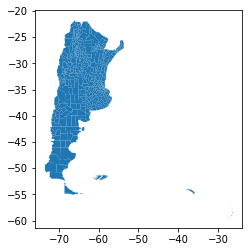

In [6]:
Arg = Arg.drop(Arg.query("link == '94028'").index, axis = 0)
Arg.plot()

In [7]:
Arg['link'] = Arg['link'].astype(int)
Arg.head()

,link,codpcia,departamen,provincia,mujeres,varones,personas,hogares,viv_part,viv_part_h,geometry
0,2001,02,Comuna 1,Ciudad Autónoma de Buenos Aires,107789,98097,205886,84468,130771,78360,"POLYGON ((-58.37501 -34.57959, -58.36690 -34.5..."
1,2002,02,Comuna 2,Ciudad Autónoma de Buenos Aires,89890,68042,157932,73156,107967,70869,"POLYGON ((-58.40084 -34.57126, -58.40005 -34.5..."
2,2003,02,Comuna 3,Ciudad Autónoma de Buenos Aires,101936,85601,187537,80489,101161,75605,"POLYGON ((-58.39365 -34.60154, -58.39348 -34.6..."
3,2004,02,Comuna 4,Ciudad Autónoma de Buenos Aires,115079,103166,218245,76455,82926,69680,"POLYGON ((-58.35695 -34.61980, -58.35672 -34.6..."
4,6091,06,Berazategui,Buenos Aires,165636,158608,324244,93164,96025,86248,"POLYGON ((-58.01702 -34.78120, -58.08380 -34.8..."


In [9]:
covid = pd.read_csv('Covid19Casos.csv')
covid.head()

,id_evento_caso,sexo,edad,edad_años_meses,residencia_pais_nombre,residencia_provincia_nombre,residencia_departamento_nombre,carga_provincia_nombre,fecha_inicio_sintomas,fecha_apertura,sepi_apertura,fecha_internacion,cuidado_intensivo,fecha_cui_intensivo,fallecido,fecha_fallecimiento,asistencia_respiratoria_mecanica,carga_provincia_id,origen_financiamiento,clasificacion,clasificacion_resumen,residencia_provincia_id,fecha_diagnostico,residencia_departamento_id,ultima_actualizacion
0,1000000,M,54.0,Años,Argentina,CABA,SIN ESPECIFICAR,Buenos Aires,NaN,2020-06-01,23,NaN,NO,NaN,NO,NaN,NO,6,Privado,Caso Descartado,Descartado,2,2020-06-09,0,2021-06-15
1,10000000,F,52.0,Años,Argentina,CABA,SIN ESPECIFICAR,CABA,NaN,2021-04-08,14,NaN,NO,NaN,NO,NaN,NO,2,Público,Caso Descartado,Descartado,2,2021-04-08,0,2021-06-15
2,10000001,F,22.0,Años,Argentina,Buenos Aires,Lomas de Zamora,Buenos Aires,2021-04-05,2021-04-08,14,NaN,NO,NaN,NO,NaN,NO,6,Público,Caso Descartado,Descartado,6,2021-04-08,490,2021-06-15
3,10000002,F,44.0,Años,Argentina,Buenos Aires,La Matanza,CABA,NaN,2021-04-08,14,NaN,NO,NaN,NO,NaN,NO,2,Público,Caso Descartado,Descartado,6,2021-04-06,427,2021-06-15
4,10000003,F,33.0,Años,Argentina,CABA,COMUNA 01,CABA,NaN,2021-04-08,14,NaN,NO,NaN,NO,NaN,NO,2,Público,Caso Descartado,Descartado,2,2021-04-08,1,2021-06-15


In [10]:
gen_datos = pre.preparar_datos(covid)
del(covid)
covid_geo = gen_datos.fit()
covid_geo.dtypes

id_evento_caso                                   int64
sexo                                            object
edad                                           float64
edad_años_meses                                 object
residencia_pais_nombre                          object
residencia_provincia_nombre                     object
residencia_departamento_nombre                  object
carga_provincia_nombre                          object
fecha_inicio_sintomas                   datetime64[ns]
fecha_apertura                          datetime64[ns]
sepi_apertura                                    int64
fecha_internacion                       datetime64[ns]
cuidado_intensivo                                 bool
fecha_cui_intensivo                     datetime64[ns]
fallecido                                         bool
fecha_fallecimiento                     datetime64[ns]
asistencia_respiratoria_mecanica                  bool
carga_provincia_id                               int64
origen_fin

In [ ]:
campos_desc = ['edad_años_meses', 'residencia_pais_nombre','residencia_provincia_nombre','residencia_departamento_nombre',
               'carga_provincia_nombre','sepi_apertura','carga_provincia_id','origen_financiamiento','clasificacion',
               'clasificacion_resumen','residencia_provincia_id','residencia_departamento_id','ultima_actualizacion']
covid_geo = covid_geo.drop(campos_desc, axis = 1)


In [1]:
claves = ['residencia_dpto','fecha_apertura']
atributos = ['clasificacion_resumen_Confirmado','fallecido','origen_financiamiento_Privado','sexo_M','origen_financiamiento_Público',
              'adulto_medio', 'adulto_mayor','cuidado_intensivo','asistencia_respiratoria_mecanica']
covid_geo.columns

NameError: ignored

In [10]:
round(sys.getsizeof(covid_geo[atributos])/(1024**2)), sys.getsizeof(Arg)/(1024**2)

(112, 0.3000917434692383)

In [11]:
# Agrupamos los datos por localidad y periodo de tiempo
agrupa = covid_geo.groupby(['residencia_dpto',covid_geo.fecha_apertura.dt.year]) 
agrupa_w = covid_geo.groupby(['residencia_dpto',covid_geo.fecha_apertura.dt.week]) 
covid_geo = agrupa[atributos].sum()
covid_geo.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.
  This is separate from the ipykernel package so we can avoid doing imports until


clasificacion_resumen_Confirmado  ...  asistencia_respiratoria_mecanica
residencia_dpto fecha_apertura                                    ...                                  
2000            2020                                     97826.0  ...                              1602
                2021                                    125237.0  ...                               847
2001            2020                                      7677.0  ...                               110
                2021                                      9104.0  ...                                59
2002            2020                                      3308.0  ...                                36

[5 rows x 9 columns]

In [12]:
index = covid_geo.index
idx = pd.IndexSlice
covid_geo.loc[idx[:,2020],:]
#index.get_level_values(1)
#idx[:,2021]

,,clasificacion_resumen_Confirmado,fallecido,origen_financiamiento_Privado,sexo_M,origen_financiamiento_Público,adulto_medio,adulto_mayor,cuidado_intensivo,asistencia_respiratoria_mecanica
residencia_dpto,fecha_apertura,,,,,,,,,
2000,2020,97826.0,4938,219549.0,185525.0,181454.0,125127.0,76670.0,4147,1602
2001,2020,7677.0,206,6206.0,10412.0,16789.0,5746.0,2982.0,210,110
2002,2020,3308.0,111,7623.0,6027.0,6655.0,3098.0,2457.0,83,36
2003,2020,6225.0,193,5699.0,8348.0,13697.0,4834.0,3224.0,162,81
2004,2020,10202.0,241,4302.0,14259.0,26987.0,7766.0,3989.0,280,159
...,...,...,...,...,...,...,...,...,...,...
94028,2020,2.0,0,4.0,16.0,16.0,5.0,0.0,0,0
99000,2020,3073.0,38,3487.0,3824.0,6681.0,2234.0,543.0,47,23
99012,2020,0.0,0,0.0,1.0,1.0,0.0,0.0,0,0


In [24]:
index = covid_geo.index
idx = pd.IndexSlice

covid_geo2020= pd.merge(covid_geo.loc[idx[:,2020],:], Arg,how= 'inner' ,left_on= 'residencia_dpto', right_on = 'link')
covid_geo2021 = pd.merge(covid_geo.loc[idx[:,2021],:], Arg,how= 'inner' ,left_on= 'residencia_dpto', right_on = 'link')


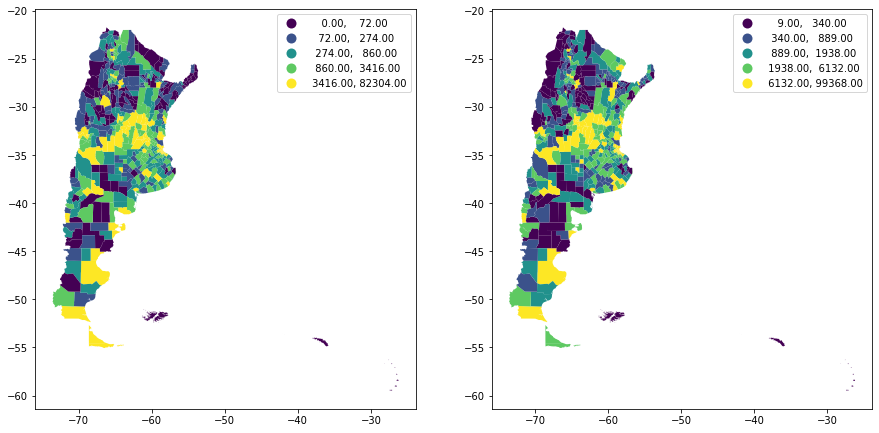

In [26]:
covid_geo2020 = gpd.GeoDataFrame(covid_geo2020)
covid_geo2021 = gpd.GeoDataFrame(covid_geo2021)
fig, ax = plt.subplots(1,2,figsize = (15,10))
covid_geo2020.plot(column = 'clasificacion_resumen_Confirmado', ax = ax[0], scheme = 'Quantiles',k = 5,legend = True, figsize = (15,15))
covid_geo2021.plot(column = 'clasificacion_resumen_Confirmado', ax = ax[1], scheme = 'Quantiles',k = 5,legend = True, figsize = (15,15))

In [ ]:
import pysal as ps 
from sklearn.cluster import KMeans, AgglomerativeClustering

In [ ]:
atributos = ['clasificacion_resumen_Confirmado','fallecido_SI','origen_financiamiento_Privado','sexo_M','varones','personas','hogares']
from sklearn import preprocessing
escalado = preprocessing.StandardScaler().fit(covid_geo[atributos])
covid_escalado = escalado.transform(covid_geo[atributos])
covid_escalado
covid_geo[atributos] = covid_geo[atributos].astype(float)
kmeans = KMeans(n_clusters = 15)
np.random.seed(91)
grupos = kmeans.fit(covid_geo[atributos])
grupos

KeyError: ignored

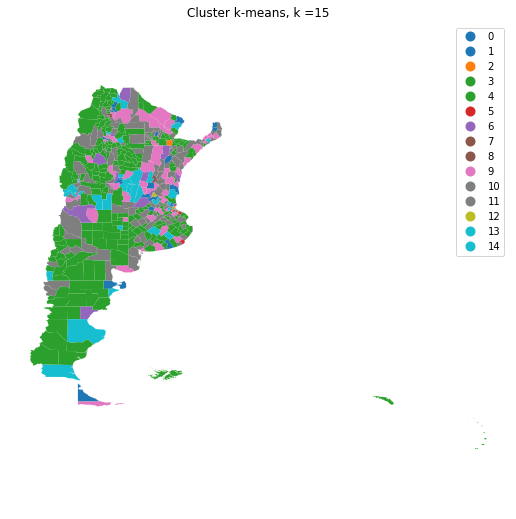

In [ ]:
covid_geo['k15cls'] = grupos.labels_
f,ax = plt.subplots(1, figsize = (9,9))
covid_geo.plot(column = 'k15cls', categorical = True, legend = True, linewidth = 0, ax = ax)
ax.set_axis_off()
plt.axis('equal')
plt.title(r'Cluster k-means, k =15')
plt.show()


In [ ]:

from cartoframes.viz import Layer, color_bins_style, formula_widget, category_widget, histogram_widget, popup_element
Layer(covid_geo,
      #encode_data = False,
      color_bins_style('k15cls', method = 'equal', breaks= range(15), palette = 'mint'),
      encode_data = False,
      widgets=[
          formula_widget('clasificacion_resumen_Confirmado','Sum','Casos COVID'),
          formula_widget('fallecido_SI','Sum','Fallecidos'),
          
          histogram_widget('fallecido_SI')
      ]
    
)

In [ ]:
covid_geo.groupby("k15cls").mean()

,clasificacion_resumen_Confirmado,clasificacion_resumen_Descartado,clasificacion_resumen_Sin Clasificar,clasificacion_resumen_Sospechoso,fallecido_NO,fallecido_SI,origen_financiamiento_Privado,origen_financiamiento_Público,sexo_F,sexo_M,sexo_NR,link,varones,personas,hogares
k15cls,,,,,,,,,,,,,,,
0,7552.360000,10936.280000,0.680000,2646.200000,20979.040000,156.480000,4141.960000,16993.560000,10643.800000,10339.160000,152.560000,42610.360000,42303.200000,8.592548e+04,24495.760000
1,142970.000000,434098.000000,7.000000,29967.000000,604857.000000,2185.000000,134801.000000,472241.000000,326387.000000,279440.000000,1215.000000,14014.000000,634341.000000,1.329604e+06,414237.000000
2,44932.833333,76979.500000,4.666667,9831.500000,130445.000000,1303.500000,47507.166667,84241.333333,66669.833333,63365.500000,1713.166667,9097.333333,204584.000000,4.198707e+05,123114.166667
3,741.423581,1255.637555,0.078603,289.689956,2272.493450,14.336245,224.685590,2062.144105,1117.096070,1150.008734,19.724891,39945.061135,5062.755459,1.000871e+04,2913.655022
4,24561.142857,47273.142857,2.000000,7635.285714,78826.571429,645.000000,25883.285714,53588.285714,40416.285714,38150.142857,905.142857,29747.000000,129112.571429,2.677373e+05,78876.714286
5,65091.333333,88339.000000,4.333333,6864.666667,158294.000000,2005.333333,85603.333333,74696.000000,83428.666667,74676.333333,2194.333333,6429.333333,302533.000000,6.298640e+05,206650.333333
6,14778.851852,29472.000000,1.518519,3943.629630,47858.000000,338.000000,12730.037037,35465.962963,25121.666667,22587.481481,486.851852,29799.740741,83907.259259,1.752666e+05,56945.925926
7,144444.000000,220712.000000,16.000000,18957.000000,379481.000000,4648.000000,152920.000000,231209.000000,193322.000000,185590.000000,5217.000000,6427.000000,866690.000000,1.775816e+06,484909.000000
8,53176.500000,65231.333333,2.833333,16183.666667,133114.333333,1480.000000,45591.166667,89003.166667,68914.000000,64210.500000,1469.833333,42900.000000,263398.500000,5.457352e+05,155441.666667


In [ ]:
from ipywidgets import interact

def plot_function(n = 6):
    cov = covid_geo.groupby('k15cls').sum()[atributos]
    columna = atributos[n]
    f, ax = plt.subplots()
    cov[columna].plot(kind = 'bar',ax = ax)
    #plt.axis('equal')
    plt.title(columna)
    plt.show()
   
interact(plot_function, n = (0,6,1))

interactive(children=(IntSlider(value=6, description='n', max=6), Output()), _dom_classes=('widget-interact',)…

<function __main__.plot_function>

In [ ]:
def ss(df):
    medias = df.mean(axis = 0)
    ssd = []
    for i in range(df.shape[1]):
        var = df[:,i]-medias[i]
        var2 = var**2
        ssd.append(sum(var2))
    ssd = np.array(ssd)
    return  sum(ssd)

def SSD(DF, columna, atrib):
    df = DF[atributos] 
    TSS = ss(escalado.transform(df))
    WSS = []
    for i in DF[columna]:
        d = df[DF[columna] == i]
        d = escalado.transform(d)
        s = ss(d)
        WSS.append(s)
    WSS = np.sum(np.array(WSS))
    BSS = TSS-WSS
    RBTSS = BSS/TSS
    return {'TSS': TSS, 'WSS': WSS, 'BSS': BSS, 'RBTSS':RBTSS}


In [ ]:
SSD(covid_geo,'k15cls', atributos)

{'BSS': 390.63007170924766,
 'RBTSS': 0.10609181741152848,
 'TSS': 3681.999999999998,
 'WSS': 3291.3699282907505}

In [ ]:
import sys

In [ ]:
sys.path.append("/MyDrive/Tesis/covid/covid/")
import preproceso as pre

In [ ]:
from google.colab import drive
drive.mount("/content/drive/")

Mounted at /content/drive/


In [ ]:
pre.campos_bool

['cuidado_intensivo', 'fallecido', 'asistencia_respiratoria_mecanica']

In [ ]:
"/content/drive/MyDrive/Tesis/covid/covid/"